In [1]:
import os 
import cv2
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import keras 
from keras.callbacks import EarlyStopping,ModelCheckpoint
import tensorflow as tf
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from tqdm import tqdm
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split

In [2]:
def data(dataset_path):
    images = []
    labels = []
    for folder in os.listdir(dataset_path):
        subfolder_path = os.path.join(dataset_path, folder)
        for subfolder in os.listdir(subfolder_path):
            subfolder_path1 = os.path.join(subfolder_path, subfolder)
            if not os.path.isdir(subfolder_path):
                continue
            for image_filename in os.listdir(subfolder_path1):               
                if image_filename.endswith(".jpg"):
                    image_path = os.path.join(subfolder_path1, image_filename)
                    images.append(image_path)
                    labels.append(subfolder)
    df = pd.DataFrame({'image': images, 'label': labels})
    return df

In [8]:
train=data('C:/Users/HP/OneDrive/Desktop/TCS/Skin Cancer Prediction/Skin cancer ISIC The International Skin Imaging Collaboration')
train.head()

,image,label
0,C:/Users/HP/OneDrive/Desktop/TCS/Skin Cancer P...,actinic keratosis
1,C:/Users/HP/OneDrive/Desktop/TCS/Skin Cancer P...,actinic keratosis
2,C:/Users/HP/OneDrive/Desktop/TCS/Skin Cancer P...,actinic keratosis
3,C:/Users/HP/OneDrive/Desktop/TCS/Skin Cancer P...,actinic keratosis
4,C:/Users/HP/OneDrive/Desktop/TCS/Skin Cancer P...,actinic keratosis


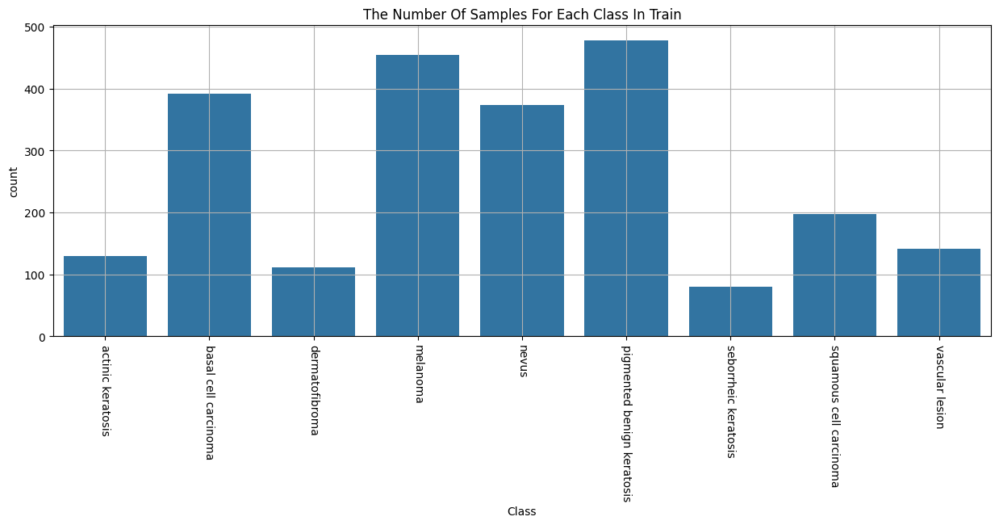

In [9]:
plt.figure(figsize=(15,5))
ax = sns.countplot(x=train.label)
ax.set_xlabel("Class")
plt.title("The Number Of Samples For Each Class In Train")
plt.grid(True)
plt.xticks(rotation=-90)
plt.show()

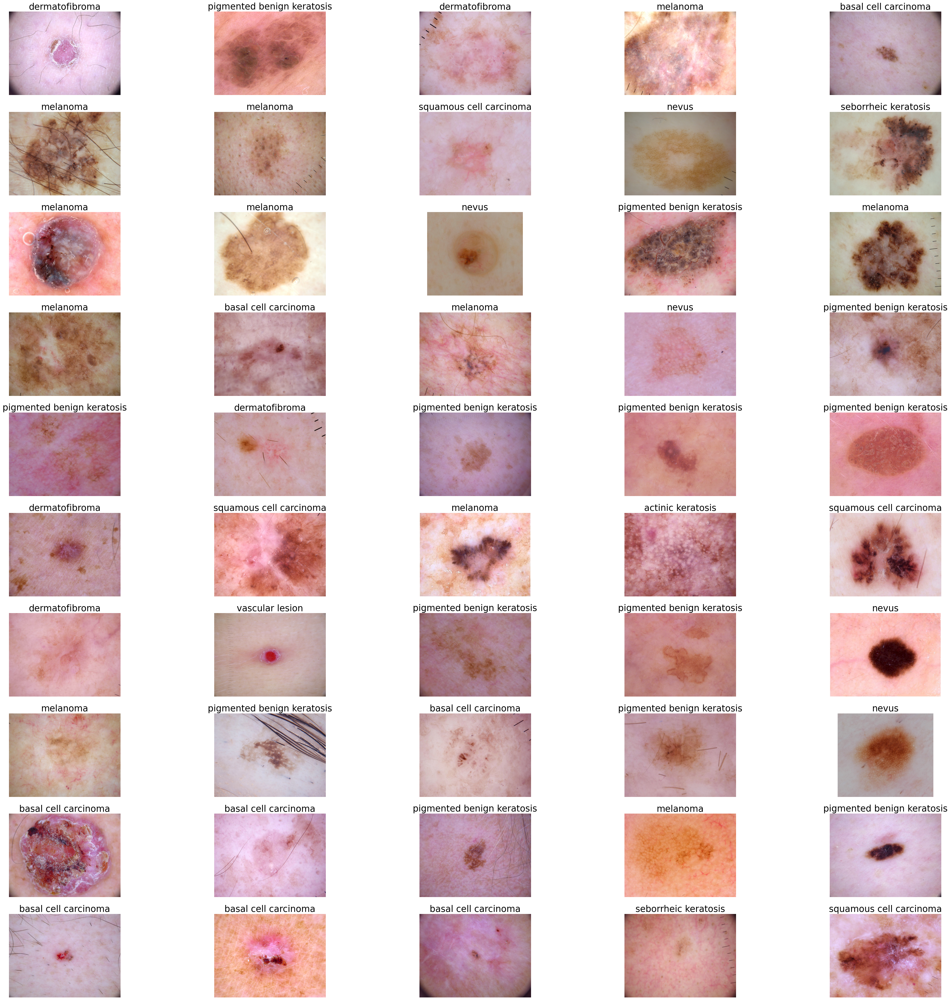

In [10]:
plt.figure(figsize=(50,50))
for n,i in enumerate(np.random.randint(0,len(train),50)):
    plt.subplot(10,5,n+1)
    img=cv2.imread(train.image[i])
    img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.axis('off')
    plt.title(train.label[i],fontsize=25)

In [11]:
df_train,df_test = train_test_split(train,test_size=.2,stratify=train.label,shuffle=True,random_state=41)

In [12]:
image_size = (176, 176)
batch_size = 1700 
datagen = ImageDataGenerator(
    rescale=1./255,
    
)
train_generator = datagen.flow_from_dataframe(
    df_train,
    x_col='image',
    y_col='label',
    target_size=image_size,
    batch_size=batch_size,
    shuffle=True
)
test_generator = datagen.flow_from_dataframe(
    df_test,
    x_col='image',
    y_col='label',
    target_size=image_size,
    batch_size=batch_size,
    shuffle=False
)

Found 1885 validated image filenames belonging to 9 classes.
Found 472 validated image filenames belonging to 9 classes.


In [13]:
train_iter = iter(train_generator)
train_data, train_labels = next(train_iter)

In [18]:
from imblearn.over_sampling import RandomOverSampler

# Apply RandomOverSampler
ros = RandomOverSampler(random_state=41)
train_data_resampled, train_labels_resampled = ros.fit_resample(train_data_flattened, train_labels)

# Reshape back if needed
train_data_resampled = train_data_resampled.reshape(-1, height, width, channels)
print(train_data_resampled.shape, train_labels_resampled.shape)


(3069, 176, 176, 3) (3069, 9)


In [19]:
class_num=list(train_generator.class_indices.keys())
class_num

['actinic keratosis',
 'basal cell carcinoma',
 'dermatofibroma',
 'melanoma',
 'nevus',
 'pigmented benign keratosis',
 'seborrheic keratosis',
 'squamous cell carcinoma',
 'vascular lesion']

C:\Users\HP\AppData\Local\Temp\ipykernel_9656\1235763819.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x=labels,palette='Set1')


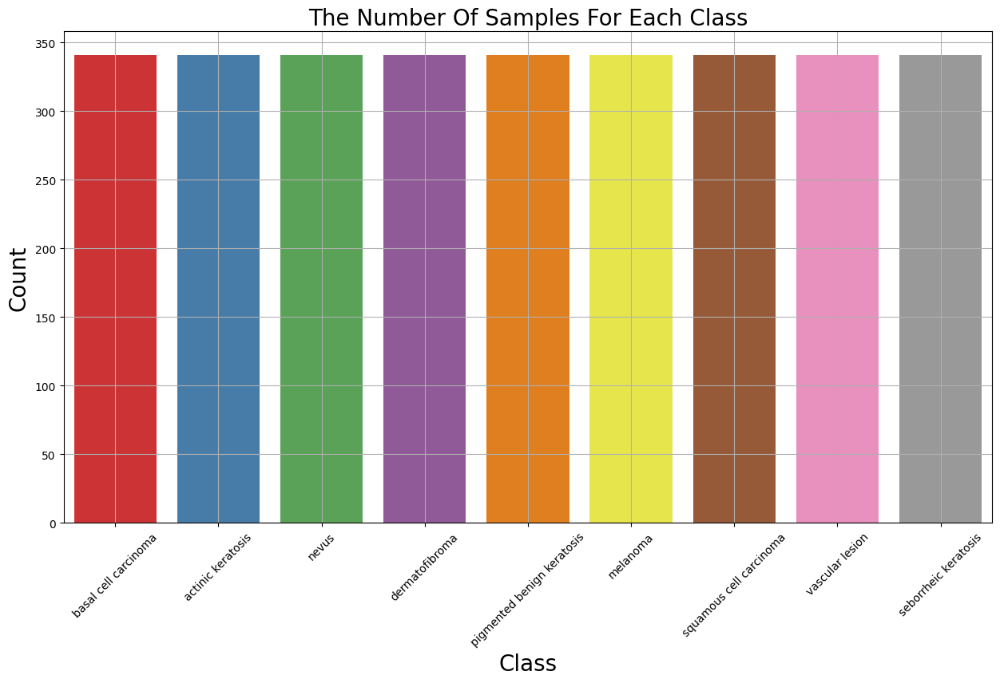

In [21]:
labels=[class_num[i] for i in np.argmax(train_labels_resampled,axis=1) ]
plt.figure(figsize=(15,8))
ax = sns.countplot(x=labels,palette='Set1')
ax.set_xlabel("Class",fontsize=20)
ax.set_ylabel("Count",fontsize=20)
plt.title('The Number Of Samples For Each Class',fontsize=20)
plt.grid(True)
plt.xticks(rotation=45)
plt.show()

In [22]:
model=keras.models.Sequential()
model.add(keras.layers.Conv2D(32,kernel_size=(3,3),strides=2,padding='same',activation='relu',input_shape=(176,176,3)))
model.add(keras.layers.MaxPool2D(pool_size=(2,2),strides=2,padding='same'))
model.add(keras.layers.Conv2D(64,kernel_size=(3,3),strides=2,activation='relu',padding='same'))
model.add(keras.layers.MaxPool2D((2,2),2,padding='same'))
model.add(keras.layers.Conv2D(128,kernel_size=(3,3),strides=2,activation='relu',padding='same'))
model.add(keras.layers.MaxPool2D((2,2),2,padding='same'))
model.add(keras.layers.Flatten())
model.add(keras.layers.Dense(1024,activation='relu'))
model.add(keras.layers.Dropout(0.3))
model.add(keras.layers.Dense(9,activation='softmax'))
model.summary()

C:\Users\HP\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 88, 88, 32)          │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 44, 44, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 22, 22, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 11, 11, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 6, 6, 128)           │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 3, 3, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 1152)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1024)                │       1,180,672 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 1024)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 9)                   │           9,225 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,283,145 (4.89 MB)

 Trainable params: 1,283,145 (4.89 MB)

 Non-trainable params: 0 (0.00 B)

In [25]:
checkpoint_cb =ModelCheckpoint("my_keras_model.keras", save_best_only=True)
early_stopping_cb =EarlyStopping(patience=5, restore_best_weights=True)
model.compile(optimizer ='adam', loss='categorical_crossentropy', metrics=['accuracy',keras.metrics.SpecificityAtSensitivity(0.5),keras.metrics.AUC()])
hist=model.fit(train_data_resampled,train_labels_resampled,validation_split=.1,epochs=50,callbacks=[checkpoint_cb,early_stopping_cb])

Epoch 1/50
87/87 ━━━━━━━━━━━━━━━━━━━━ 17s 138ms/step - accuracy: 0.5142 - auc_1: 0.8957 - loss: 1.2763 - specificity_at_sensitivity_1: 0.9483 - val_accuracy: 0.7134 - val_auc_1: 0.9645 - val_loss: 0.7314 - val_specificity_at_sensitivity_1: 1.0000
Epoch 2/50
87/87 ━━━━━━━━━━━━━━━━━━━━ 12s 134ms/step - accuracy: 0.6144 - auc_1: 0.9352 - loss: 1.0197 - specificity_at_sensitivity_1: 0.9763 - val_accuracy: 0.8111 - val_auc_1: 0.9831 - val_loss: 0.5131 - val_specificity_at_sensitivity_1: 1.0000
Epoch 3/50
87/87 ━━━━━━━━━━━━━━━━━━━━ 10s 115ms/step - accuracy: 0.6370 - auc_1: 0.9384 - loss: 0.9914 - specificity_at_sensitivity_1: 0.9816 - val_accuracy: 0.7329 - val_auc_1: 0.9739 - val_loss: 0.6418 - val_specificity_at_sensitivity_1: 0.9996
Epoch 4/50
87/87 ━━━━━━━━━━━━━━━━━━━━ 12s 136ms/step - accuracy: 0.6881 - auc_1: 0.9563 - loss: 0.8387 - specificity_at_sensitivity_1: 0.9885 - val_accuracy: 0.8893 - val_auc_1: 0.9898 - val_loss: 0.3933 - val_specificity_at_sensitivity_1: 1.0000
Epoch 5/50
8

In [26]:
hist_=pd.DataFrame(hist.history)
hist_

,accuracy,auc_1,loss,specificity_at_sensitivity_1,val_accuracy,val_auc_1,val_loss,val_specificity_at_sensitivity_1
0,0.546343,0.909493,1.200798,0.957956,0.713355,0.964501,0.731385,1.000000
1,0.614048,0.933068,1.033887,0.974928,0.811075,0.983095,0.513075,1.000000
2,0.643736,0.941889,0.965797,0.981399,0.732899,0.973912,0.641838,0.999593
3,0.701665,0.956191,0.835923,0.989048,0.889251,0.989810,0.393328,1.000000
4,0.734251,0.964998,0.744995,0.992578,0.866450,0.993944,0.332268,1.000000
5,0.775887,0.973006,0.652265,0.994207,0.859935,0.990464,0.396081,1.000000
6,0.792904,0.975993,0.610058,0.995112,0.902280,0.995483,0.278488,1.000000
7,0.835988,0.983026,0.505987,0.996877,0.967427,0.999615,0.122354,1.000000
8,0.859884,0.987951,0.427921,0.998009,0.973941,0.999587,0.111267,1.000000
9,0.874728,0.989084,0.385255,0.997918,0.928339,0.997778,0.187480,1.000000


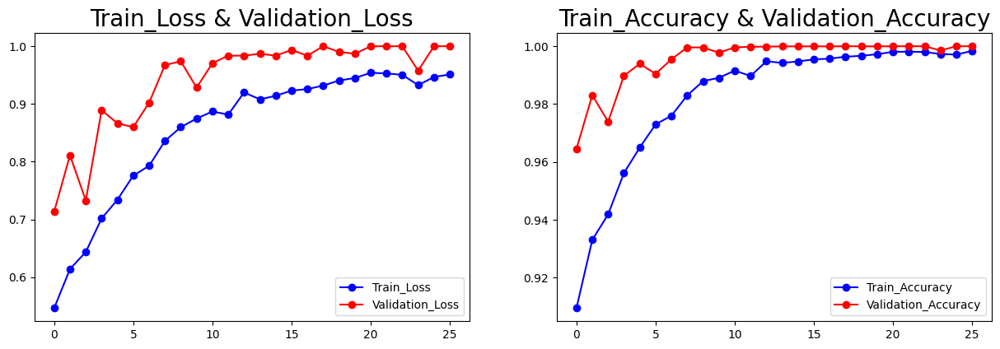

In [27]:
plt.figure(figsize=(15,10))
plt.subplot(2,2,1)
plt.plot(hist_.iloc[:,0],'b-o',label='Train_Loss')
plt.plot(hist_.iloc[:,4],'r-o',label='Validation_Loss')
plt.title('Train_Loss & Validation_Loss',fontsize=20)
plt.legend()
plt.subplot(2,2,2)
plt.plot(hist_.iloc[:,1],'b-o',label='Train_Accuracy')
plt.plot(hist_.iloc[:,5],'r-o',label='Validation_Accuracy')
plt.title('Train_Accuracy & Validation_Accuracy',fontsize=20)
plt.legend()
plt.show()

In [28]:
score, acc,sensitivity,auc = model.evaluate(test_generator)
print('Test Loss =', score)
print('Test Accuracy =', acc)
print('Test Sensitivity =', sensitivity)
print('Test AUC =', auc)

C:\Users\HP\anaconda3\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


1/1 ━━━━━━━━━━━━━━━━━━━━ 12s 12s/step - accuracy: 0.5636 - auc_1: 0.8692 - loss: 2.1917 - specificity_at_sensitivity_1: 0.9555
Test Loss = 2.191749095916748
Test Accuracy = 0.5635592937469482
Test Sensitivity = 0.9555084705352783
Test AUC = 0.8691515922546387


In [30]:
y_test =test_generator.classes
predictions = model.predict(test_generator)
y_pred = np.argmax(predictions,axis=1)
y_test = np.ravel(y_test)
y_pred = np.ravel(y_pred)
df = pd.DataFrame({'Actual': y_test, 'Prediction': y_pred})
df

1/1 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step


,Actual,Prediction
0,5,5
1,4,0
2,4,4
3,3,4
4,8,8
...,...,...
467,5,7
468,3,4
469,5,5
470,6,3


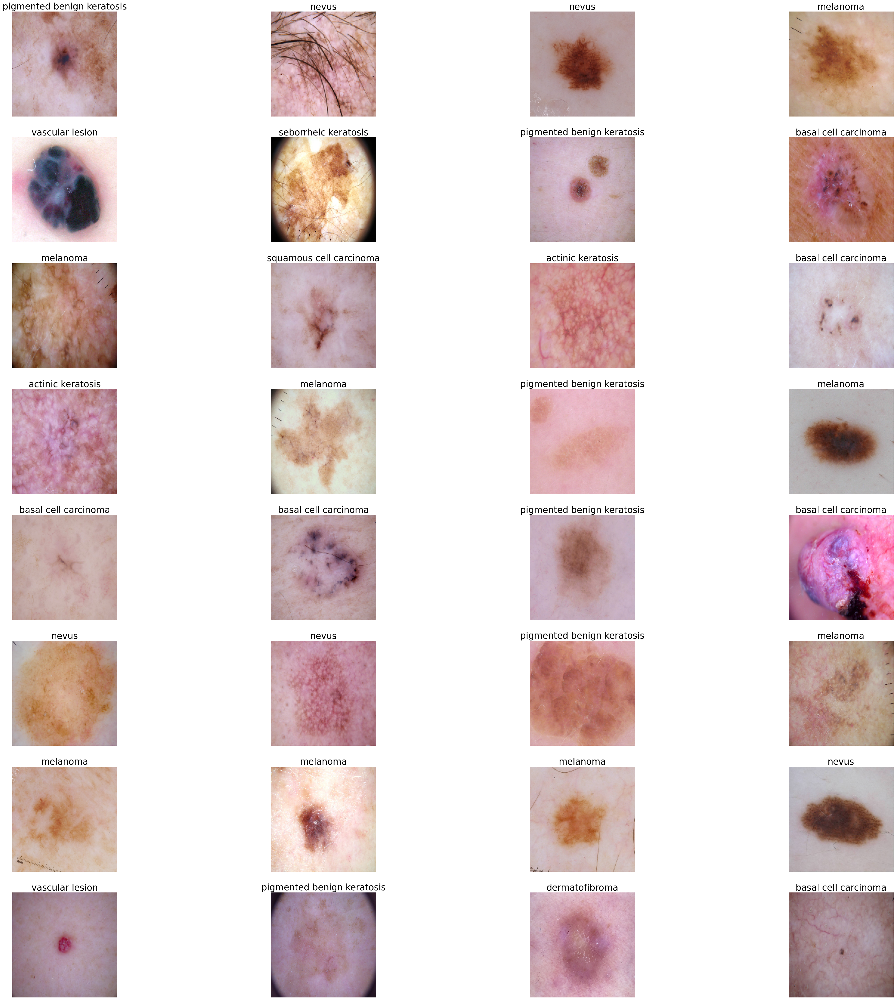

In [31]:
batch = next(test_generator)
images= batch[0]
plt.figure(figsize=(50,50))
for n in range(32):
    plt.subplot(8,4,n+1)
    plt.imshow(images[n])
    plt.axis('off')
    plt.title(class_num[int(y_test[n])],fontsize=25)

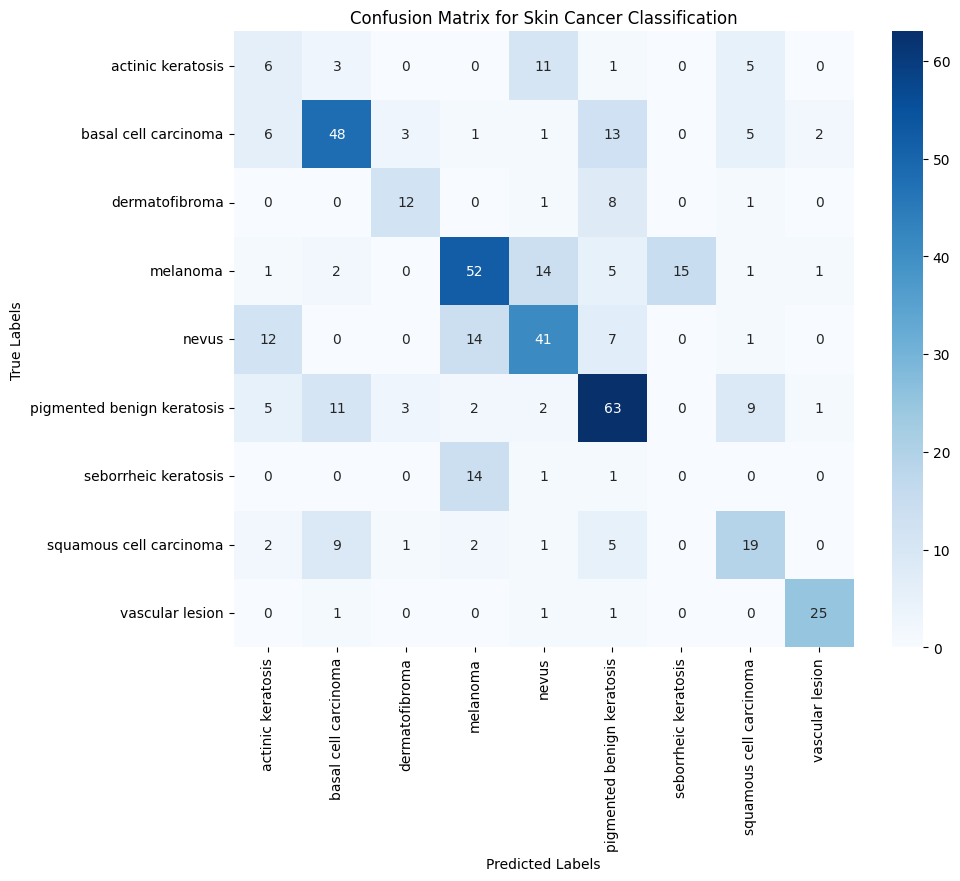

Confusion Matrix:
[[ 6  3  0  0 11  1  0  5  0]
 [ 6 48  3  1  1 13  0  5  2]
 [ 0  0 12  0  1  8  0  1  0]
 [ 1  2  0 52 14  5 15  1  1]
 [12  0  0 14 41  7  0  1  0]
 [ 5 11  3  2  2 63  0  9  1]
 [ 0  0  0 14  1  1  0  0  0]
 [ 2  9  1  2  1  5  0 19  0]
 [ 0  1  0  0  1  1  0  0 25]]


In [35]:


# Generate the confusion matrix
CM = confusion_matrix(y_test, y_pred)

classes = [
    'actinic keratosis',
 'basal cell carcinoma',
 'dermatofibroma',
 'melanoma',
 'nevus',
 'pigmented benign keratosis',
 'seborrheic keratosis',
 'squamous cell carcinoma',
 'vascular lesion'
]

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(CM, annot=True, fmt='g', cmap='Blues', xticklabels=classes, yticklabels=classes)
plt.title("Confusion Matrix for Skin Cancer Classification")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

# Print the confusion matrix values for reference
print("Confusion Matrix:")
print(CM)


In [39]:
ClassificationReport = classification_report(y_test,y_pred,target_names=classes)
print('Classification Report is : \n', ClassificationReport )

Classification Report is : 
                             precision    recall  f1-score   support

         actinic keratosis       0.19      0.23      0.21        26
      basal cell carcinoma       0.65      0.61      0.63        79
            dermatofibroma       0.63      0.55      0.59        22
                  melanoma       0.61      0.57      0.59        91
                     nevus       0.56      0.55      0.55        75
pigmented benign keratosis       0.61      0.66      0.63        96
      seborrheic keratosis       0.00      0.00      0.00        16
   squamous cell carcinoma       0.46      0.49      0.48        39
           vascular lesion       0.86      0.89      0.88        28

                  accuracy                           0.56       472
                 macro avg       0.51      0.50      0.51       472
              weighted avg       0.57      0.56      0.57       472



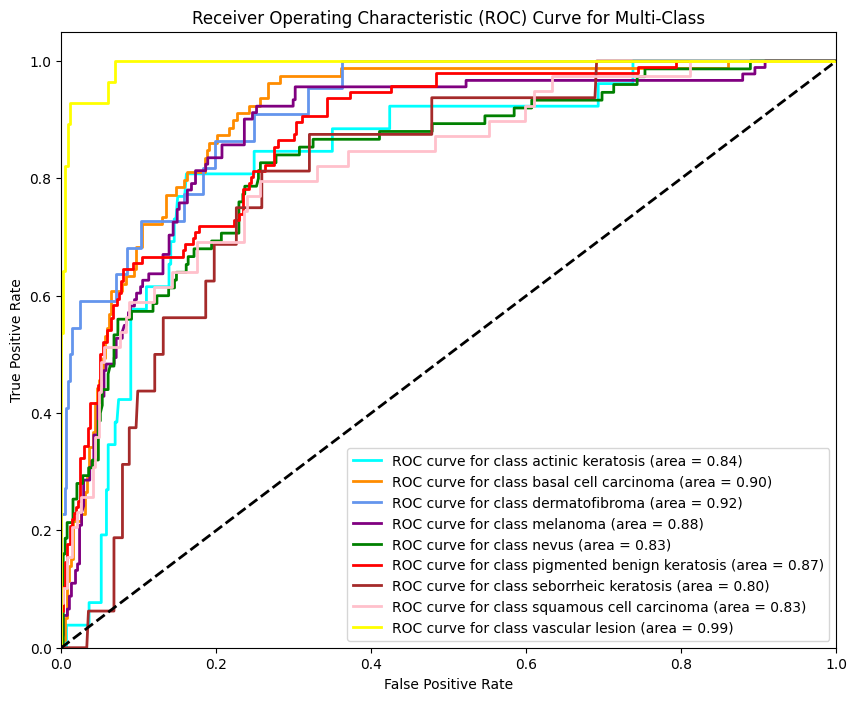

In [41]:
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_auc_score
import matplotlib.pyplot as plt
from itertools import cycle

# Assuming y_test and y_prob (predicted probabilities) are available
# Binarize the output (for multi-class)
y_test_binarized = label_binarize(y_test, classes=range(len(classes)))

# Compute ROC curve and ROC area for each class
fpr = {}
tpr = {}
roc_auc = {}
n_classes = len(classes)

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_binarized[:, i], predictions[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot ROC curve for each class
plt.figure(figsize=(10, 8))
colors = cycle(['aqua', 'darkorange', 'cornflowerblue', 'purple', 'green', 'red', 'brown', 'pink', 'yellow'])

for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f"ROC curve for class {classes[i]} (area = {roc_auc[i]:.2f})")

# Plot diagonal line
plt.plot([0, 1], [0, 1], 'k--', lw=2)

# Plot formatting
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve for Multi-Class')
plt.legend(loc="lower right")
plt.show()
